In [4]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

In [5]:
IMGS_PATH = "../Images/7_dias/Normais/images/"
MASKS_PATH = "../Images/7_dias/Normais/masks/"
IMGS_CUT_PATH = "../Images/7_dias/Normais/images_cut"
MASKS_CUT_PATH = "../Images/7_dias/Normais/masks_cut"

def imshow_components(labels):
    # Map component labels to hue val
    label_hue = np.uint8(179*labels/np.max(labels))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # cvt to BGR for display
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # set bg label to black
    labeled_img[label_hue==0] = 0
    plt.figure(figsize=(50, 50))
    plt.imshow(labeled_img)
    plt.show()

def find_extremes(img):
    north = [0, 0]
    south = [0, 0]
    east =[0, 0]
    west = [0, 0]
    for y in range(img.shape[0]):
        for x in range(img.shape[1]):
            if img[y][x] == True:
                if north == [0,0] or west == [0,0]:
                    north = [y,x]
                    west = [y,x]
                if y < north[0]:
                    north = [y,x]
                if x > east[1]:
                    east = [y,x]
                if y > south[0]:
                    south = [y,x]
                if x < west[1]:
                    west = [y,x]
    return north, south, east, west
                    
def draw_box(img, north, south, east, west):
    cv2.line(img, (west[1], south[0]), (east[1], south[0]), (255, 0, 0), 5, 1)
    cv2.line(img, (west[1], north[0]), (east[1], north[0]), (255, 0, 0), 5, 1)
    cv2.line(img, (west[1], south[0]), (west[1], north[0]), (255, 0, 0), 5, 1)
    cv2.line(img, (east[1], north[0]), (east[1], south[0]), (255, 0, 0), 5, 1)
    plt.figure(figsize=(50, 50))
    plt.imshow(img)
    plt.show()

def get_image(img_name):
    image_path = os.path.join(IMGS_PATH, img_name)
    image = cv2.imread(image_path,1)  
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return image


def get_image_pair(img_name):
    image_path = os.path.join(IMGS_PATH, img_name)
    mask_path = os.path.join(MASKS_PATH, img_name)
    image = cv2.imread(image_path,1)  
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(mask_path,0)
    return image, mask

def pre_process(image):
    kernel = np.ones((2,2),np.uint8)
    
    opening_img = cv2.morphologyEx(cv2.cvtColor(image, cv2.COLOR_RGB2GRAY), cv2.MORPH_OPEN, kernel)
    
    th,thresh_img = cv2.threshold(opening_img, 50, 255, cv2.THRESH_TOZERO)
    
    

    num_components, components = cv2.connectedComponents(thresh_img, connectivity=8)
    print("Number of components:", num_components)

    
#     plt.figure(figsize=(50, 50))
#     plt.imshow(thresh_img, cmap='gray')
#     plt.show()
    
    return num_components, components, thresh_img

def save_image(image_name, image, idx):
    if image is None:
        return
    if image.shape[0] < 40 or image.shape[1] < 40:
        return
    if not os.path.exists(IMGS_CUT_PATH):
        os.makedirs(IMGS_CUT_PATH)
    
    img_path = os.path.join(IMGS_CUT_PATH, image_name.split('.')[0] + "_" + str(idx) + "." + image_name.split('.')[1])
    print(img_path)
    cv2.imwrite(img_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

def save_images(image_name, image, mask, idx):
    if image is None or mask is None:
        return
    if image.shape[0] < 40 or image.shape[1] < 40:
        return
    if not os.path.exists(IMGS_CUT_PATH):
        os.makedirs(IMGS_CUT_PATH)
    if not os.path.exists(MASKS_CUT_PATH):
        os.makedirs(MASKS_CUT_PATH)
    
    img_path = os.path.join(IMGS_CUT_PATH, image_name.split('.')[0] + "_" + str(idx) + "." + image_name.split('.')[1])
    mask_path = os.path.join(MASKS_CUT_PATH, image_name + image_name.split('.')[0] + "_" + str(idx) + "." + image_name.split('.')[1])
    print(img_path, mask_path)
    cv2.imwrite(img_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
    cv2.imwrite(mask_path, cv2.cvtColor(mask, cv2.COLOR_RGB2BGR))

def grid_image(image):
    
    # Grid lines at these intervals (in pixels)
    # dx and dy can be different
    dx, dy = 864, 450
    
    if image.shape[0] > image.shape[1]:
        dx, dy = dy, dx

    # Custom (rgb) grid color
    grid_color = [255,255,255]

    # Modify the image to include the grid
    image[:,::dy,:] = grid_color
    image[::dx,:,:] = grid_color

def cut_images_func(image_names, hasMask = False):
    for image_name in image_names:
        if hasMask is True:
            image, mask = get_image_pair(image_name)
        else:
            image = get_image(image_name)

        print(image.shape)

        num_components, components, processed_image = pre_process(image)   
        
        imshow_components(components)
        
        
        for component_idx in range(1, num_components - 1):
            if np.count_nonzero(components == component_idx) < 100:
#                 print(np.count_nonzero(components == component_idx))
                continue
            component = components[:,:] == component_idx
            north, south, east, west = find_extremes(component)
            if abs(north[0] - south[0]) < 40 or abs(east[1] - west[1]) < 40:
                print("Corte pequeno demais")
                continue
        #     draw_box(img, north, south, east, west)
            image_cut = image[north[0]:south[0], west[1]:east[1]]
            if hasMask is True:
                mask_cut = mask[north[0]:south[0], west[1]:east[1]]
                save_images(image_name, image_cut, mask_cut, component_idx)
            else:
                save_image(image_name, image_cut, component_idx)

(3456, 4608, 3)
(3456, 4608, 3)
Number of components: 2543
Number of components: 1619
(4608, 3456, 3)
(3456, 4608, 3)
(3456, 4608, 3)
(3456, 4608, 3)
Number of components: 2897
Number of components: 2024
Number of components: 5559
(3456, 4608, 3)
Number of components: 2329
Number of components: 5945
(3456, 4608, 3)
(4608, 3456, 3)
(3456, 4608, 3)
(3456, 4608, 3)
(3456, 4608, 3)
Number of components: 2534
Number of components: 6917
(4608, 3456, 3)
(3456, 4608, 3)
(3456, 4608, 3)
(3456, 4608, 3)
Number of components: 3145
(3456, 4608, 3)
(3456, 4608, 3)
Number of components: 3221
Number of components: 3084
Number of components: 3447
(3456, 4608, 3)
Number of components: 4096
Number of components: 8637
Number of components: 7515
Number of components: 4334
Number of components: 5227
Number of components: 6128
(3456, 4608, 3)
Number of components: 4765
(3456, 4608, 3)
Number of components: 6930


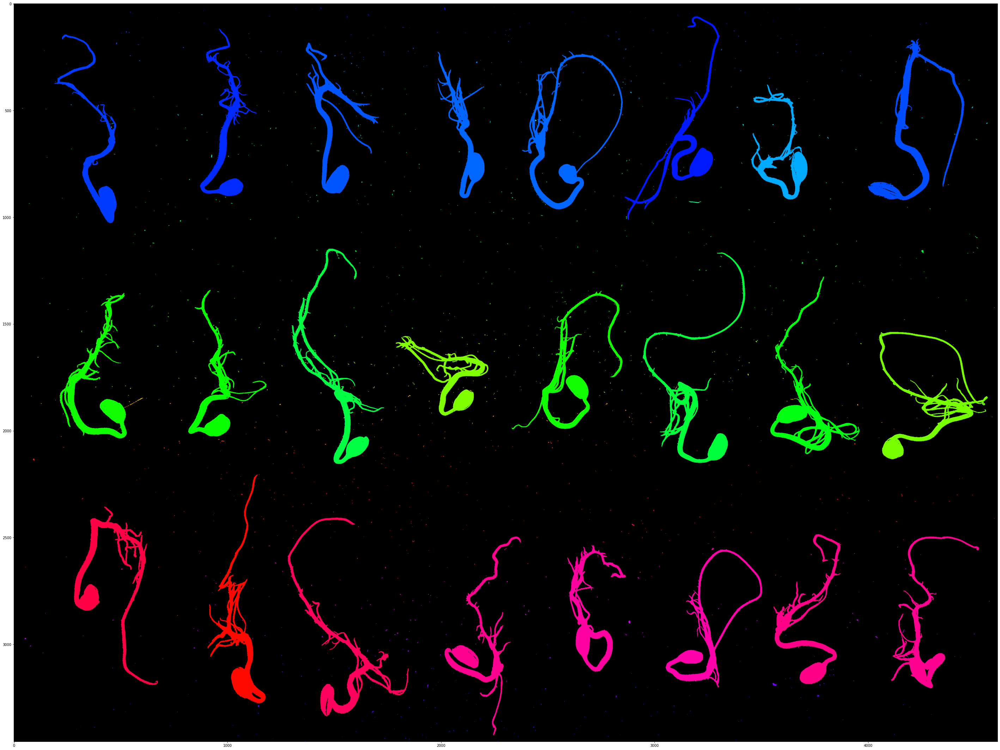

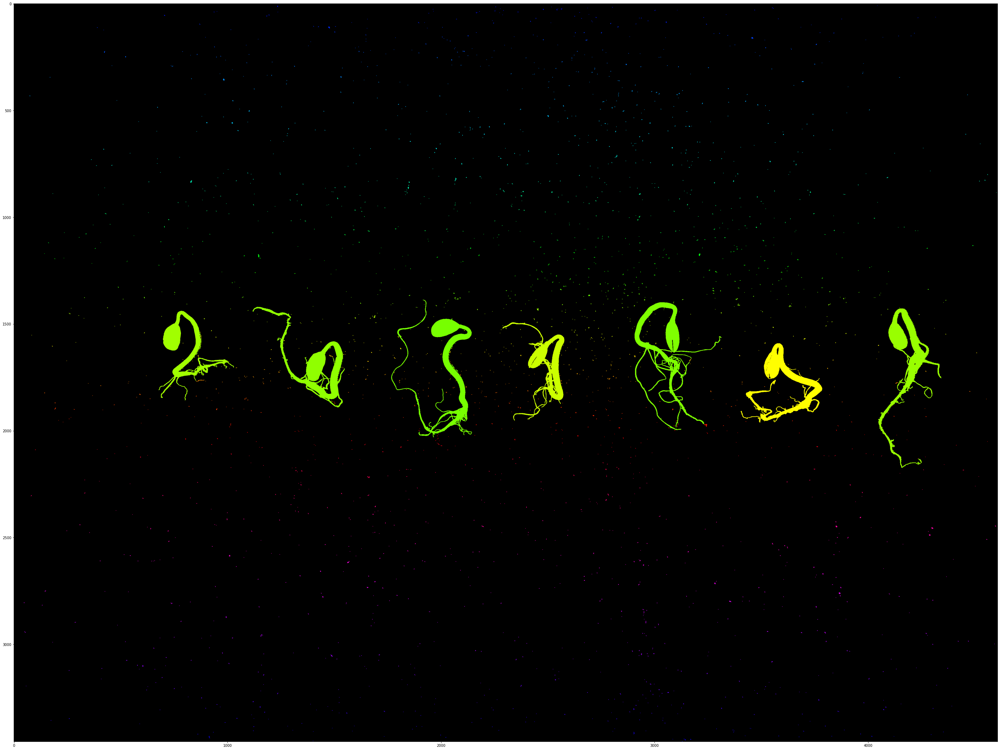

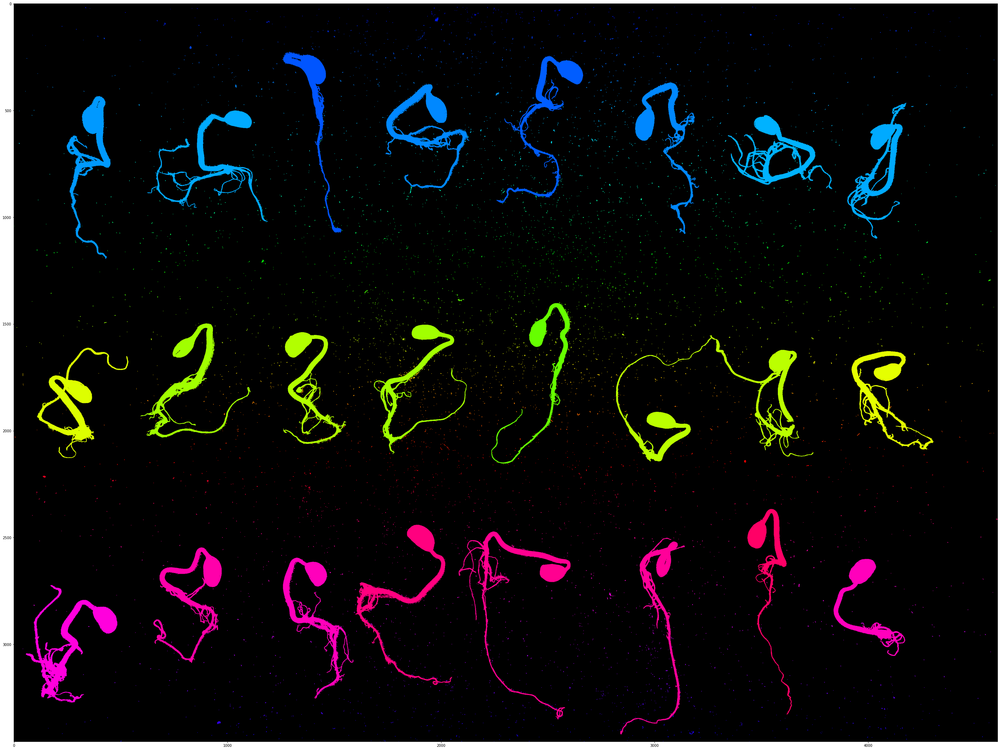

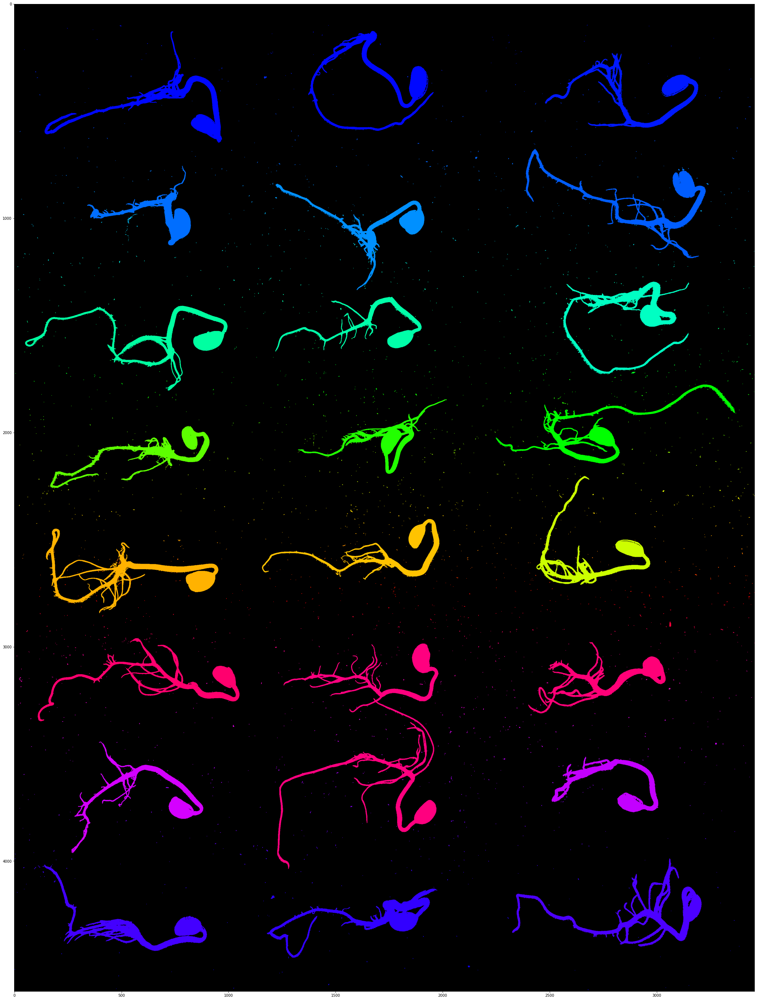

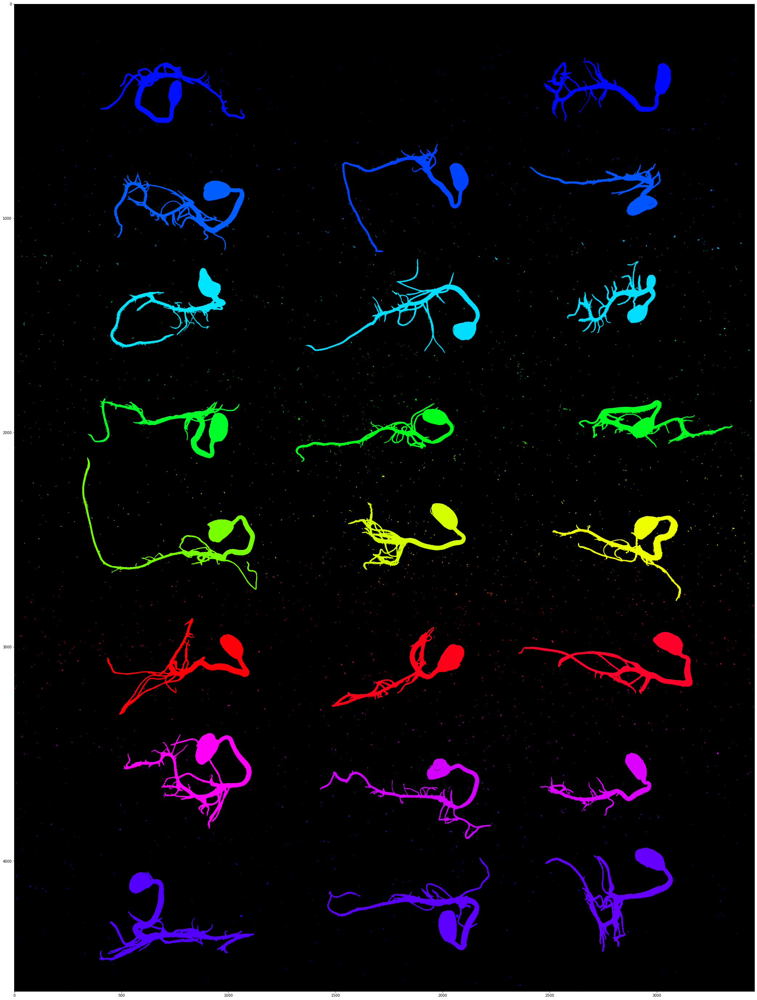

...

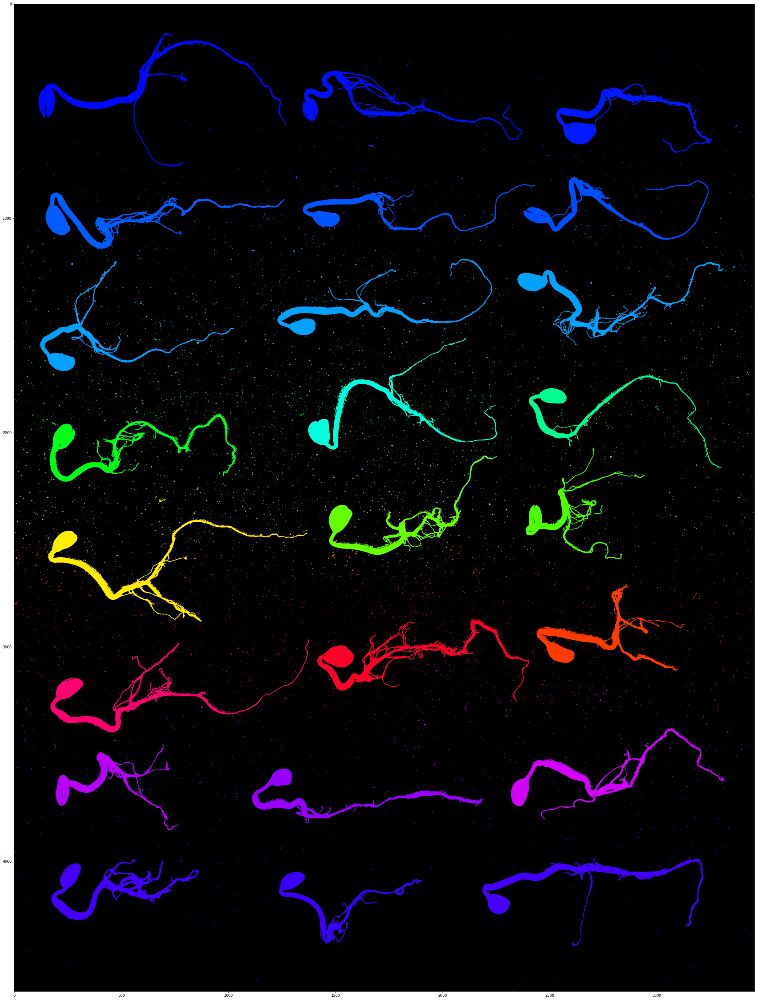

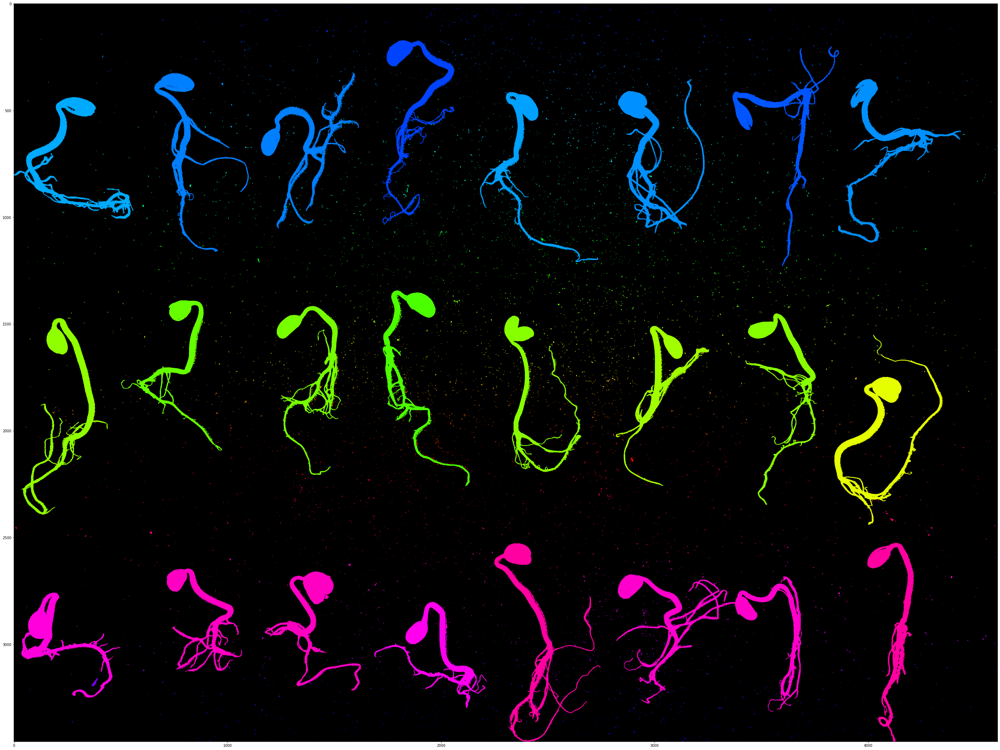

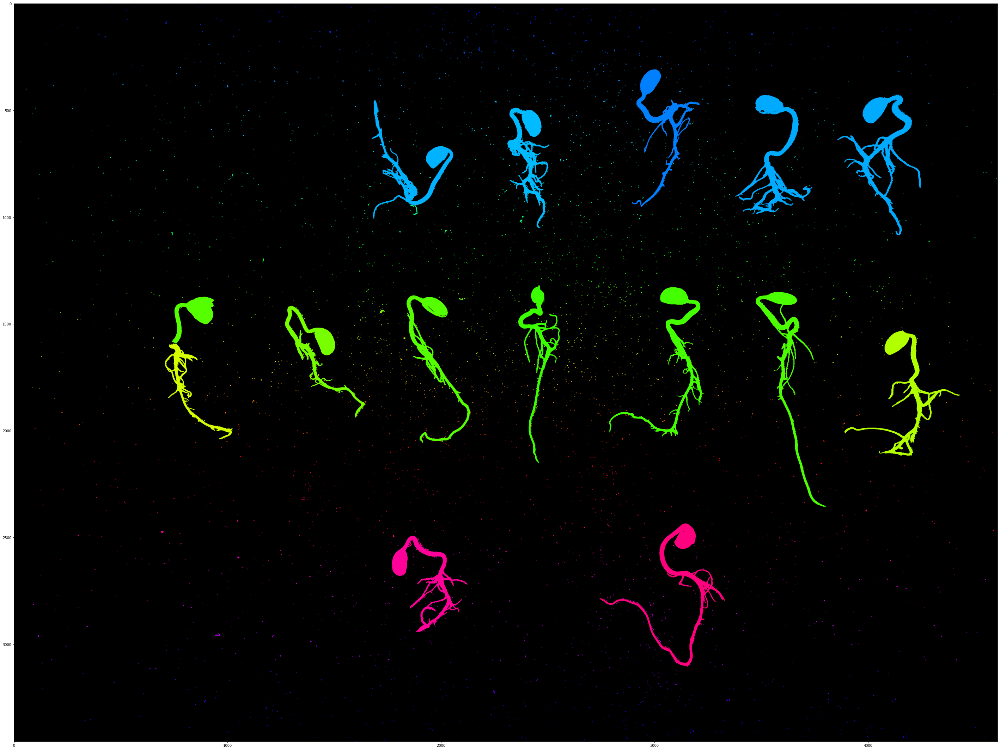

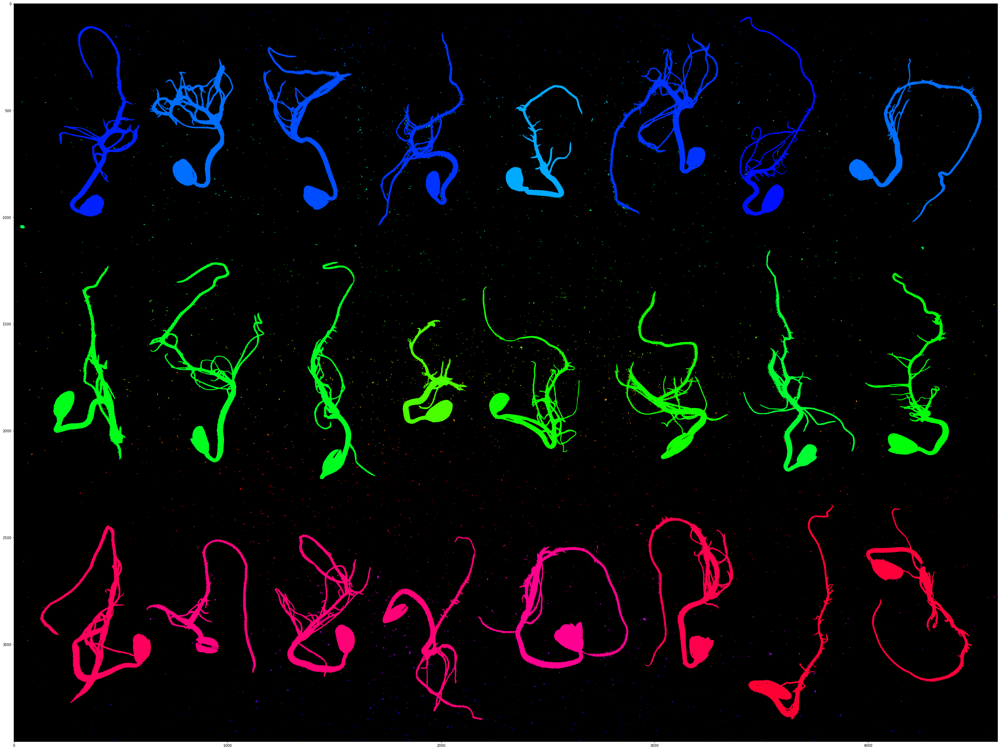

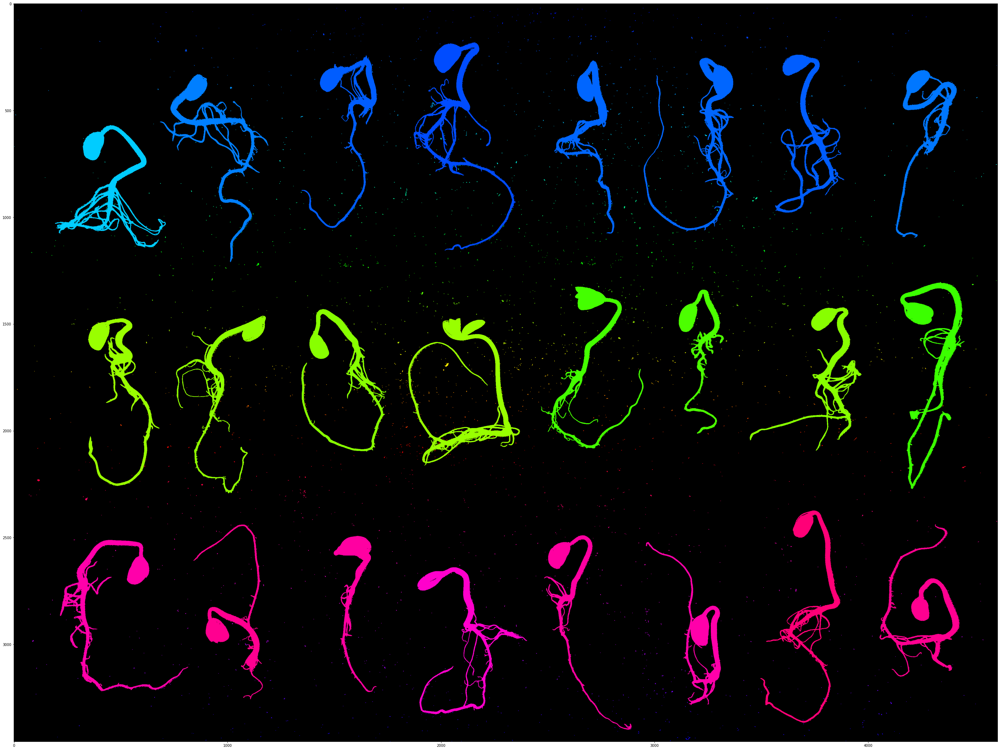

../Images/7_dias/Normais/images_cut/IMG_20201020_142402_23.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142402.pngIMG_20201020_142402_23.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_095921_3.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095921.pngIMG_20201030_095921_3.png
../Images/7_dias/Normais/images_cut/IMG_20201020_143555_33.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_143555.pngIMG_20201020_143555_33.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_46.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_46.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151549_138.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_138.png
../Images/7_dias/Normais/images_cut/IMG_20201030_093610_185.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093610.pngIMG_20201030_093610_185.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160001_55.png ../Images/7_dias/Normais/m

../Images/7_dias/Normais/images_cut/IMG_20201030_094539_393.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_094539.pngIMG_20201030_094539_393.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153520_661.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153520.pngIMG_20201113_153520_661.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154938_1105.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154938.pngIMG_20201113_154938_1105.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103848_633.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103848.pngIMG_20201030_103848_633.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142402_184.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142402.pngIMG_20201020_142402_184.png
../Images/7_dias/Normais/images_cut/IMG_20201030_093610_214.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093610.pngIMG_20201030_093610_214.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095921_149.png ../Images/7_dias/Normais/masks_cut

../Images/7_dias/Normais/images_cut/IMG_20201030_103213_374.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103213.pngIMG_20201030_103213_374.png
../Images/7_dias/Normais/images_cut/IMG_20201020_152426_260.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_152426.pngIMG_20201020_152426_260.png
../Images/7_dias/Normais/images_cut/IMG_20201030_094539_453.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_094539.pngIMG_20201030_094539_453.png
../Images/7_dias/Normais/images_cut/IMG_20201020_144941_290.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144941.pngIMG_20201020_144941_290.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153520_727.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153520.pngIMG_20201113_153520_727.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_423.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_423.png
../Images/7_dias/Normais/images_cut/IMG_20201020_150411_303.png ../Images/7_dias/Normais/masks_cut/I

Corte pequeno demais
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_637.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_637.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_739.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154355.pngIMG_20201113_154355_739.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091549_836.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091549.pngIMG_20201030_091549_836.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103213_1159.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103213.pngIMG_20201030_103213_1159.png
Corte pequeno demais
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_152634_892.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152634.pngIMG_20201113_152634_892.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103848_2156.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103848.pngIMG_20201030_103848_

../Images/7_dias/Normais/images_cut/IMG_20201020_144941_1312.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144941.pngIMG_20201020_144941_1312.png
../Images/7_dias/Normais/images_cut/IMG_20201030_094539_1825.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_094539.pngIMG_20201030_094539_1825.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_1733.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154355.pngIMG_20201113_154355_1733.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103848_2300.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103848.pngIMG_20201030_103848_2300.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153520_3203.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153520.pngIMG_20201113_153520_3203.png
../Images/7_dias/Normais/images_cut/IMG_20201030_093610_935.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093610.pngIMG_20201030_093610_935.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142402_1151.png ../Images/7_dias/Normais/

../Images/7_dias/Normais/images_cut/IMG_20201020_144941_1352.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144941.pngIMG_20201020_144941_1352.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151549_2615.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_2615.png
../Images/7_dias/Normais/images_cut/IMG_20201030_094539_1907.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_094539.pngIMG_20201030_094539_1907.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_2075.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_2075.png
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_3370.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_3370.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_3081.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153758.pngIMG_20201020_153758_3081.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_1780.png ../Images/7_dias/Normai

../Images/7_dias/Normais/images_cut/IMG_20201030_103213_2306.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103213.pngIMG_20201030_103213_2306.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_3350.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153758.pngIMG_20201020_153758_3350.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_2030.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154355.pngIMG_20201113_154355_2030.png
../Images/7_dias/Normais/images_cut/IMG_20201030_094539_3138.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_094539.pngIMG_20201030_094539_3138.png
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_4439.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_4439.png
Corte pequeno demais
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_093610_1735.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093610.pngIMG_20201030_093610_1735.png
../Images/7_dias/Normais/images_cut/IMG_202010

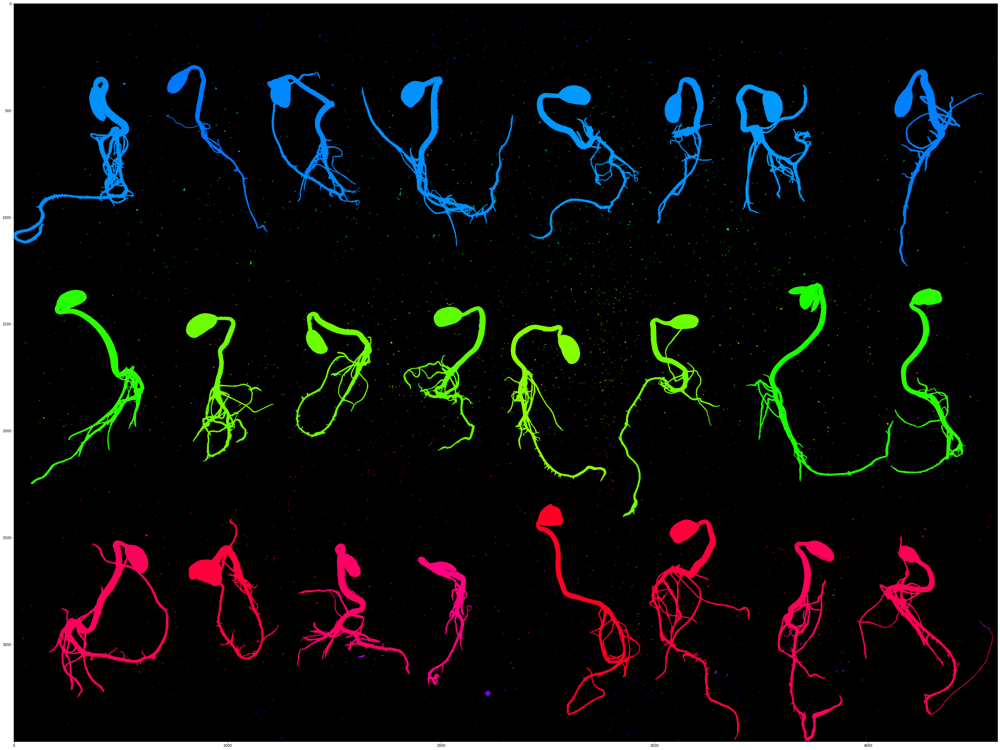

../Images/7_dias/Normais/images_cut/IMG_20201113_151549_4915.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_4915.png
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_5454.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_5454.png
../Images/7_dias/Normais/images_cut/IMG_20201030_093610_1736.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093610.pngIMG_20201030_093610_1736.png
../Images/7_dias/Normais/images_cut/IMG_20201020_143555_1190.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_143555.pngIMG_20201020_143555_1190.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201020_142402_2192.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142402.pngIMG_20201020_142402_2192.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152634_1899.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152634.pngIMG_20201113_152634_1899.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_202010

../Images/7_dias/Normais/images_cut/IMG_20201009_151538_6421.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_6421.png
../Images/7_dias/Normais/images_cut/IMG_20201020_143555_1241.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_143555.pngIMG_20201020_143555_1241.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153520_6022.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153520.pngIMG_20201113_153520_6022.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142402_2778.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142402.pngIMG_20201020_142402_2778.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103213_2392.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103213.pngIMG_20201030_103213_2392.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091549_1597.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091549.pngIMG_20201030_091549_1597.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095921_2956.png ../Images/7_dias/Normai

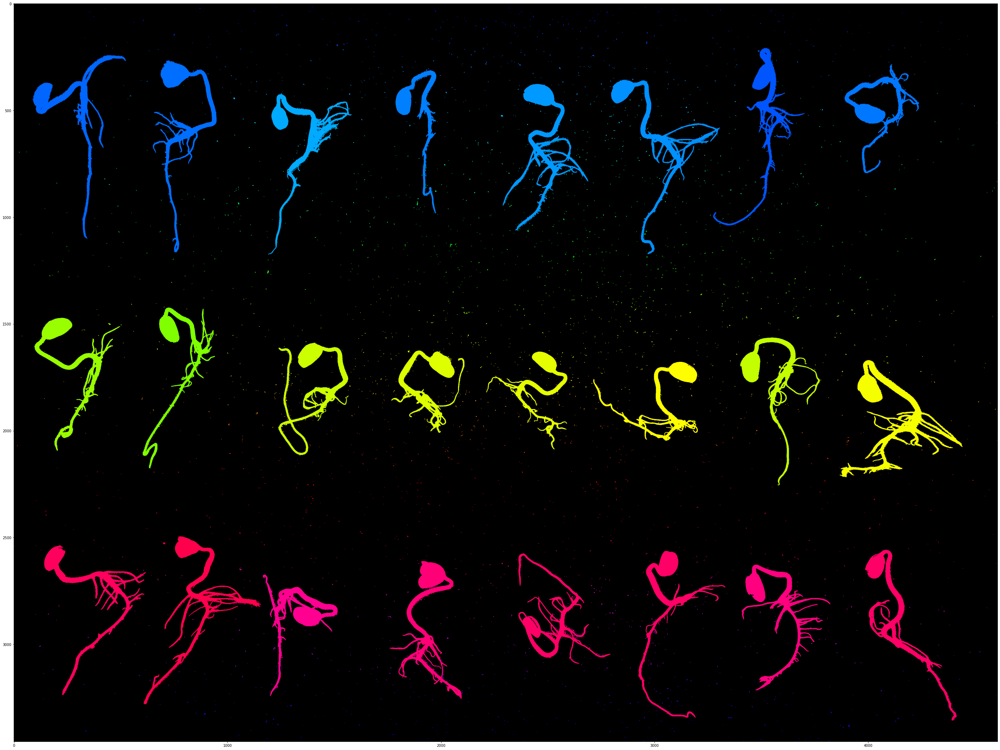

../Images/7_dias/Normais/images_cut/IMG_20201009_160001_4713.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160001.pngIMG_20201009_160001_4713.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_377.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_377.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151549_5211.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_5211.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_5418.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153758.pngIMG_20201020_153758_5418.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_3802.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154355.pngIMG_20201113_154355_3802.png
(3456, 4608, 3)
Number of components: 3257
../Images/7_dias/Normais/images_cut/IMG_20201020_143555_1269.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_143555.pngIMG_20201020_143555_1269.png
Corte pequeno demais
../Images/7_dias/Normais/i

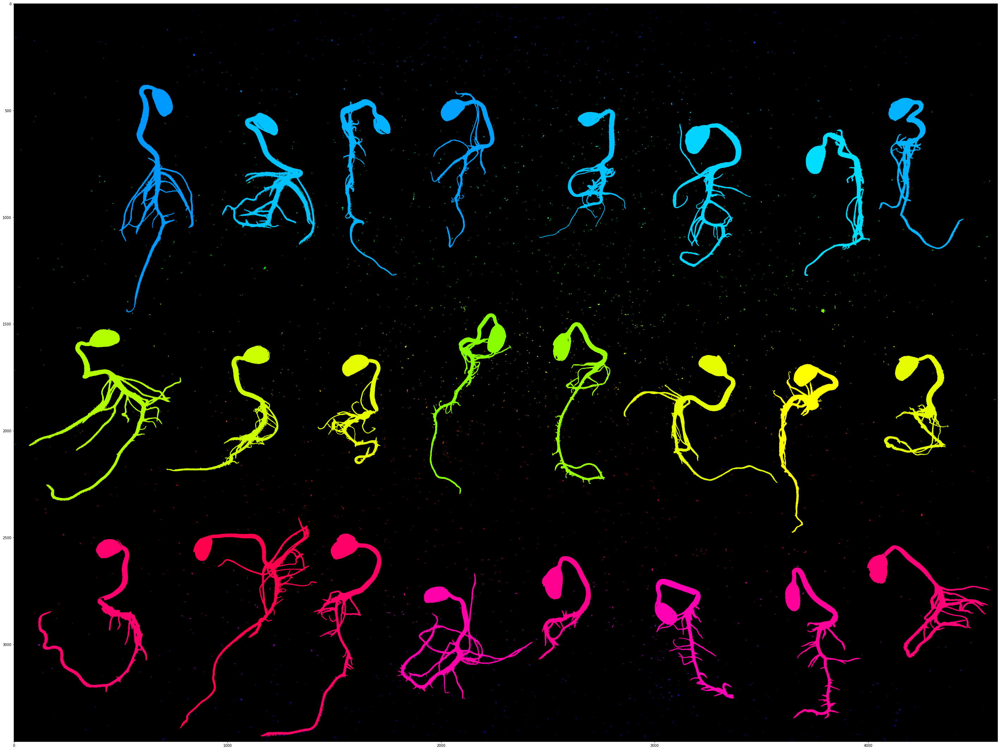

(3456, 4608, 3)
Number of components: 3534
../Images/7_dias/Normais/images_cut/IMG_20201020_142402_2830.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142402.pngIMG_20201020_142402_2830.png


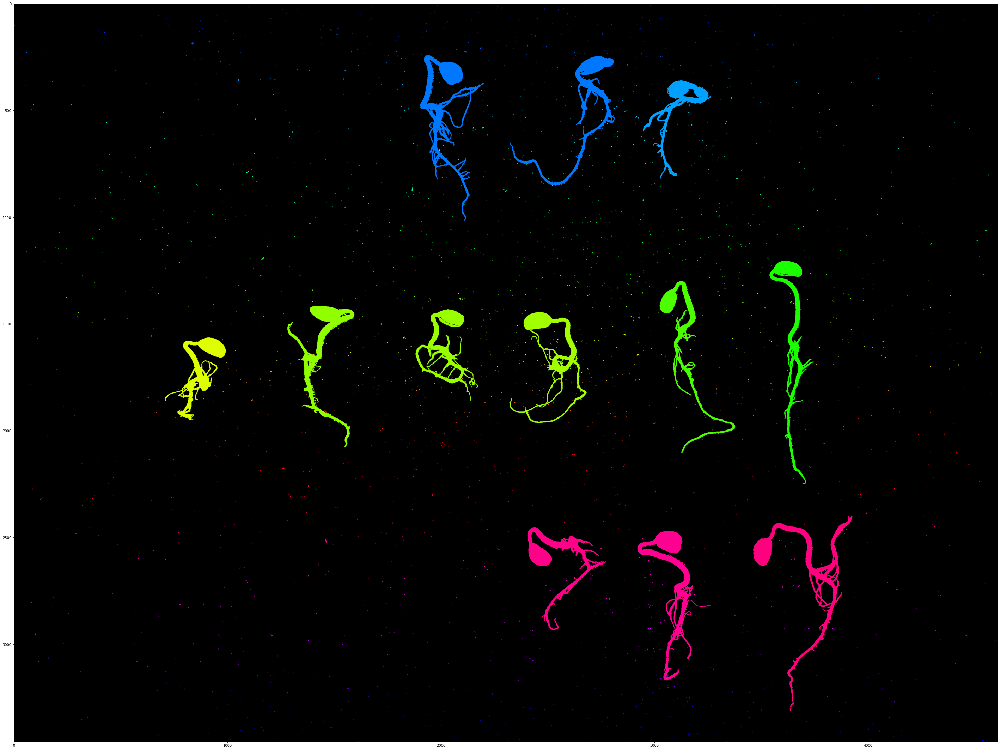

../Images/7_dias/Normais/images_cut/IMG_20201009_151538_7648.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_7648.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091549_1616.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091549.pngIMG_20201030_091549_1616.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095921_3001.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095921.pngIMG_20201030_095921_3001.png
../Images/7_dias/Normais/images_cut/IMG_20201020_152426_2534.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_152426.pngIMG_20201020_152426_2534.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152634_1961.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152634.pngIMG_20201113_152634_1961.png
(3456, 4608, 3)
Number of components: 2111
../Images/7_dias/Normais/images_cut/IMG_20201020_144941_2713.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144941.pngIMG_20201020_144941_2713.png
../Images/7_dias/Normais/images_cut/IMG_20201

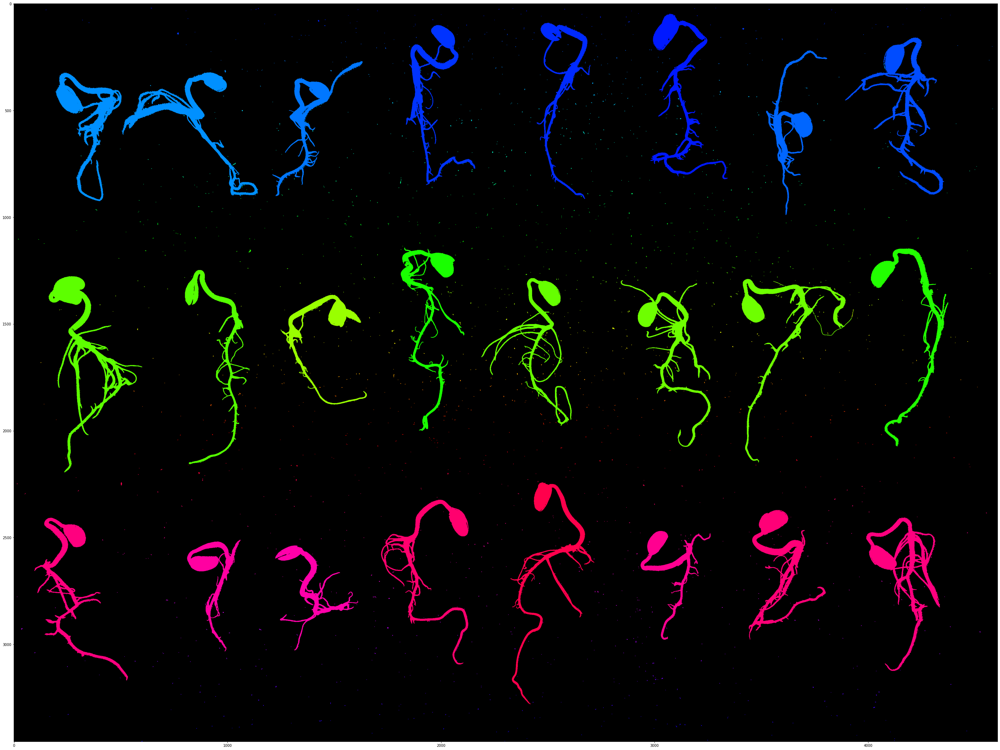

../Images/7_dias/Normais/images_cut/IMG_20201009_161509_3955.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_161509.pngIMG_20201009_161509_3955.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160001_4717.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160001.pngIMG_20201009_160001_4717.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151549_5277.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_5277.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_231.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_231.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_4206.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_4206.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_380.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_380.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_5489.png ../Images/7_dias/Normais/ma

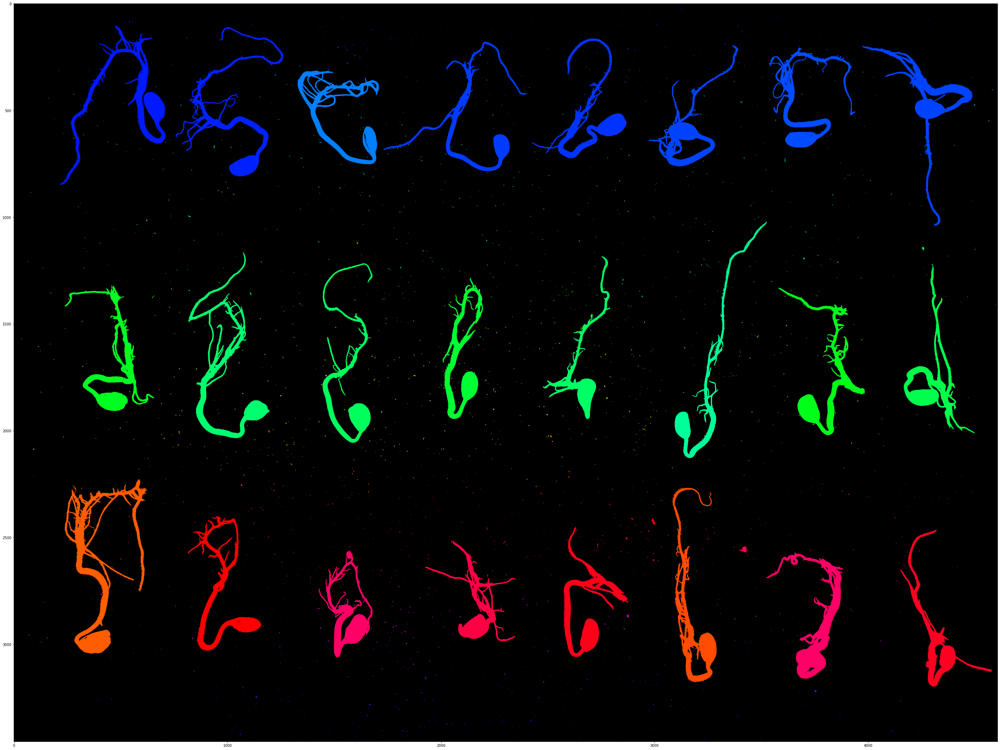

Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_093833_282.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093833.pngIMG_20201030_093833_282.png
(3456, 4608, 3)
Number of components: 2256
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_7833.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_7833.png
../Images/7_dias/Normais/images_cut/IMG_20201020_152426_2602.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_152426.pngIMG_20201020_152426_2602.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_152634_1966.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152634.pngIMG_20201113_152634_1966.png
../Images/7_dias/Normais/images_cut/IMG_20201020_144941_2716.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144941.pngIMG_20201020_144941_2716.png
(4608, 3456, 3)
Number of components: 6850


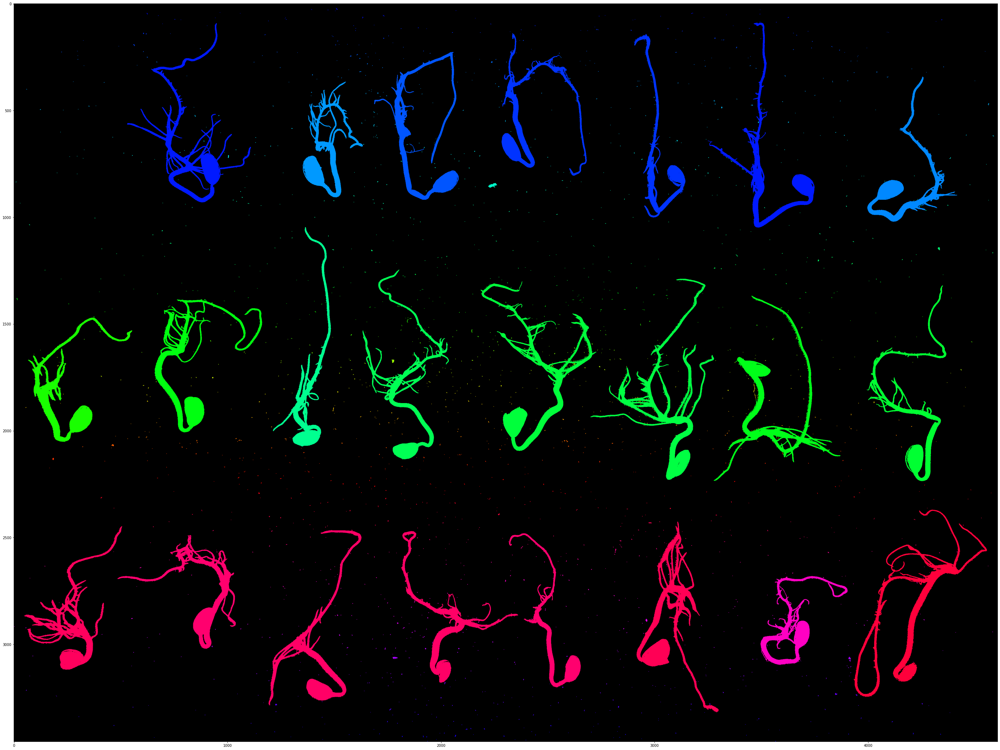

(3456, 4608, 3)
Number of components: 5523
../Images/7_dias/Normais/images_cut/IMG_20201020_150411_3137.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_150411.pngIMG_20201020_150411_3137.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091942_38.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091942.pngIMG_20201030_091942_38.png


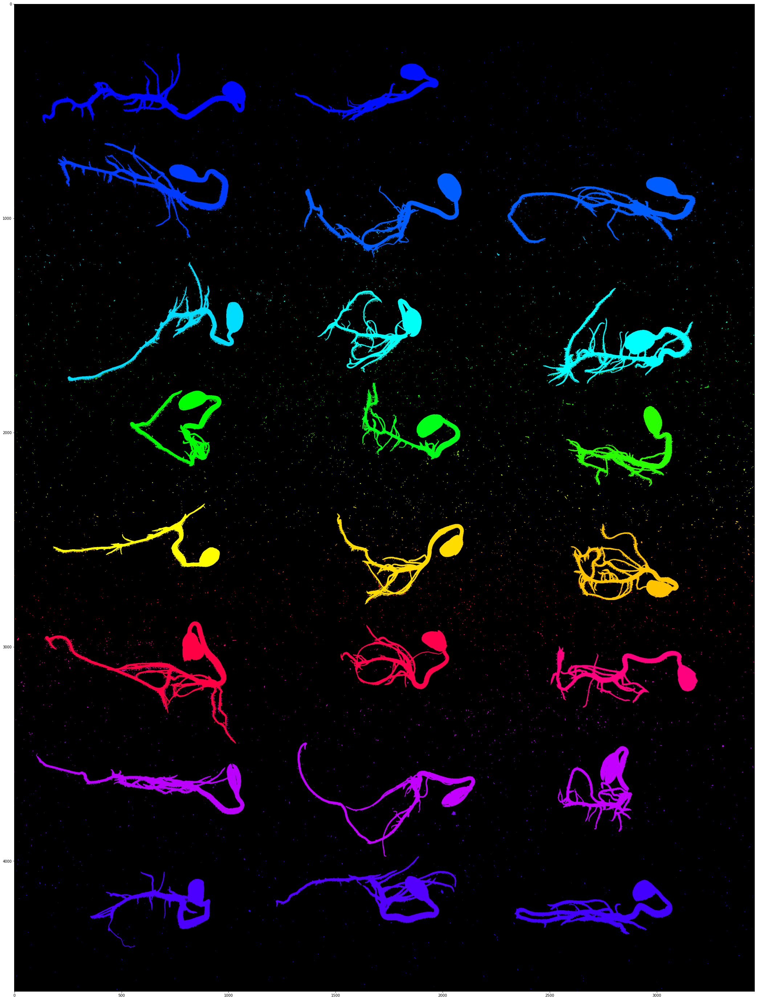

../Images/7_dias/Normais/images_cut/IMG_20201009_161509_3994.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_161509.pngIMG_20201009_161509_3994.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160001_4718.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160001.pngIMG_20201009_160001_4718.png
(3456, 4608, 3)
Number of components: 1796


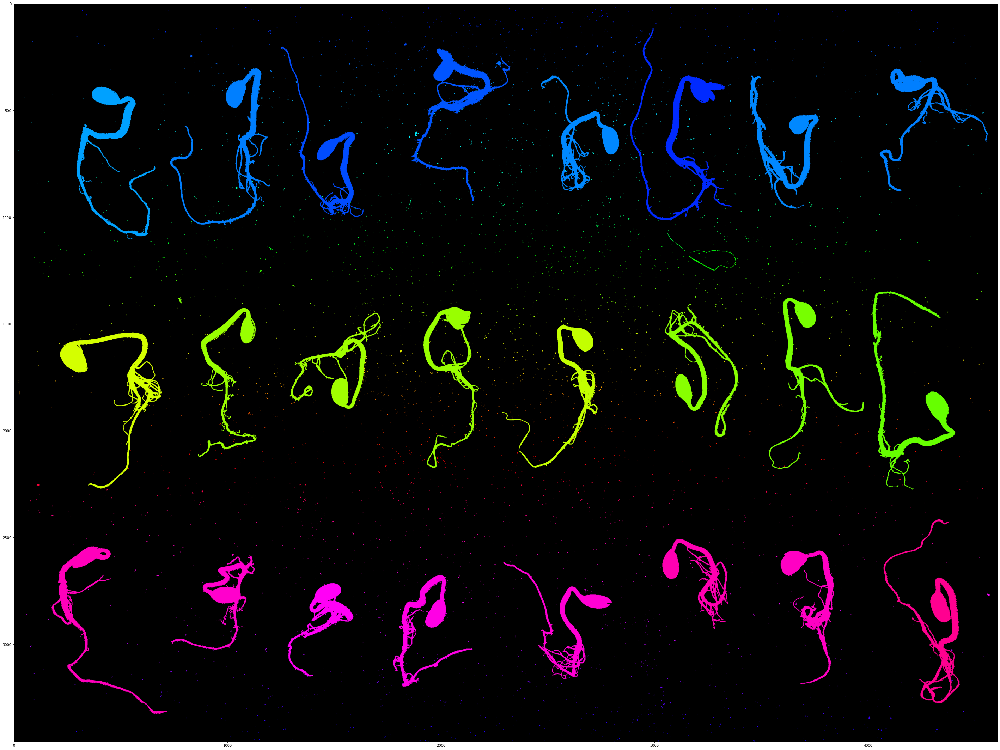

../Images/7_dias/Normais/images_cut/IMG_20201030_102354_4230.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_4230.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151549_5357.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151549.pngIMG_20201113_151549_5357.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_260.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_260.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_408.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_408.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_5496.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153758.pngIMG_20201020_153758_5496.png
(3456, 4608, 3)
Number of components: 7071


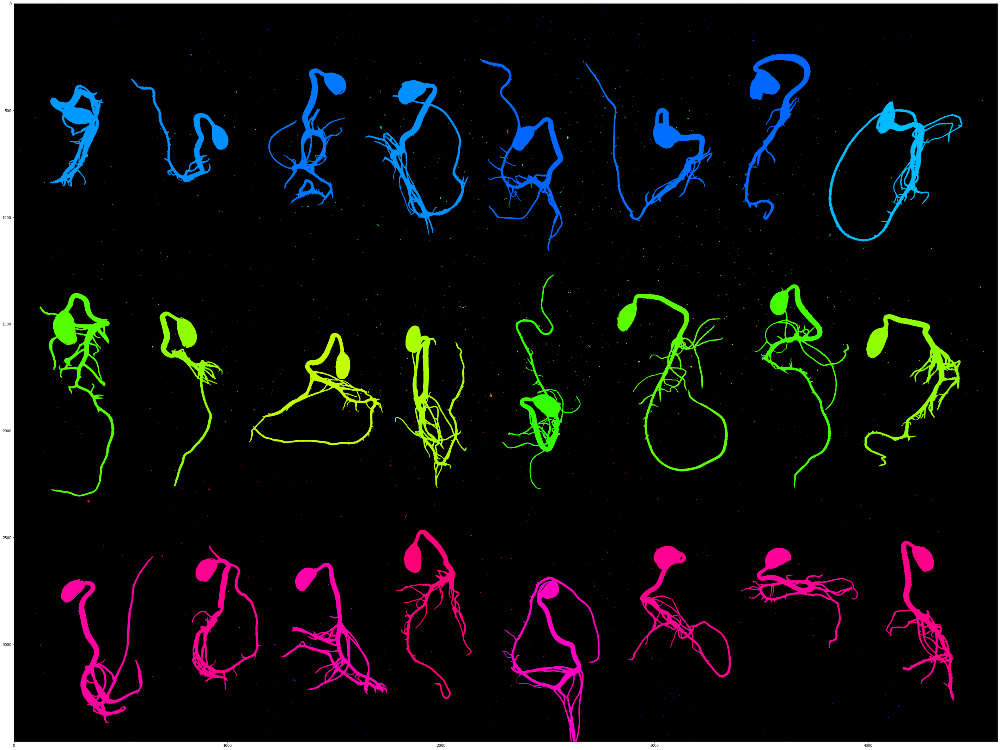

../Images/7_dias/Normais/images_cut/IMG_20201113_154355_3828.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154355.pngIMG_20201113_154355_3828.png


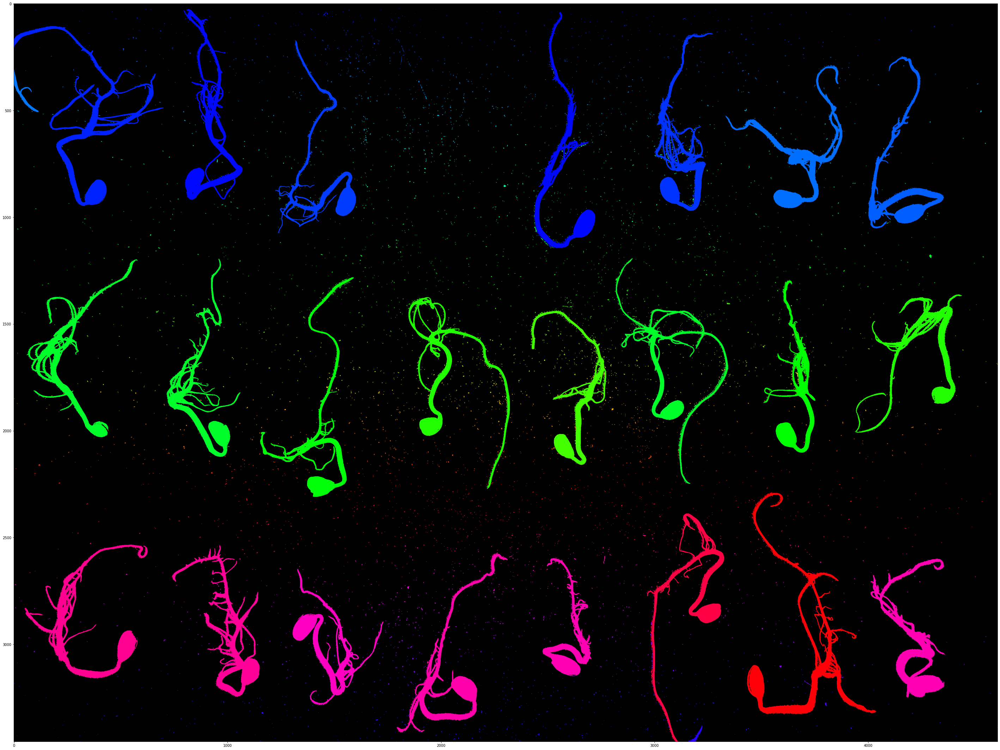

../Images/7_dias/Normais/images_cut/IMG_20201113_153520_6240.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153520.pngIMG_20201113_153520_6240.png
../Images/7_dias/Normais/images_cut/IMG_20201020_144017_42.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144017.pngIMG_20201020_144017_42.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095140_363.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_363.png
../Images/7_dias/Normais/images_cut/IMG_20201030_093833_287.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093833.pngIMG_20201030_093833_287.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152634_2030.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152634.pngIMG_20201113_152634_2030.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142947_10.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142947.pngIMG_20201020_142947_10.png
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_8319.png ../Images/7_dias/Normais/masks_cut/

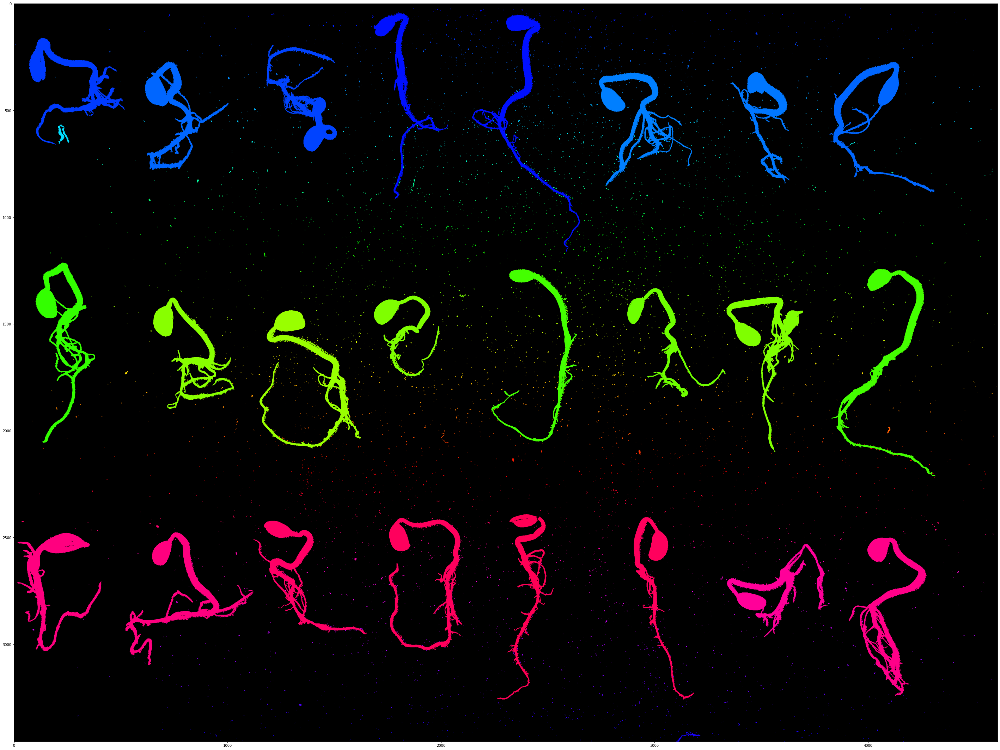

../Images/7_dias/Normais/images_cut/IMG_20201020_153249_179.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_179.png
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_412.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_412.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_4341.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_4341.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_280.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_280.png
../Images/7_dias/Normais/images_cut/IMG_20201020_145556_121.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_145556.pngIMG_20201020_145556_121.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153758_5641.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153758.pngIMG_20201020_153758_5641.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154355_3884.png ../Images/7_dias/Normais/masks_

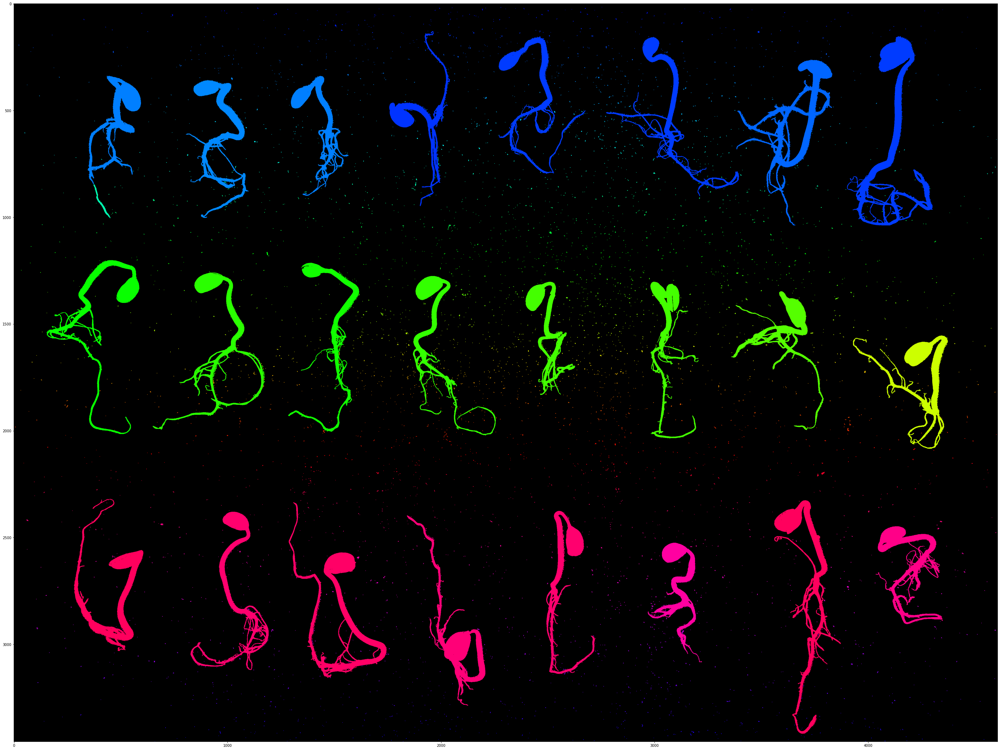

../Images/7_dias/Normais/images_cut/IMG_20201113_153002_76.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153002.pngIMG_20201113_153002_76.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_305.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_305.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160001_4942.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160001.pngIMG_20201009_160001_4942.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102354_4384.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102354.pngIMG_20201030_102354_4384.png
../Images/7_dias/Normais/images_cut/IMG_20201020_145556_127.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_145556.pngIMG_20201020_145556_127.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153249_308.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_308.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201020_150926_

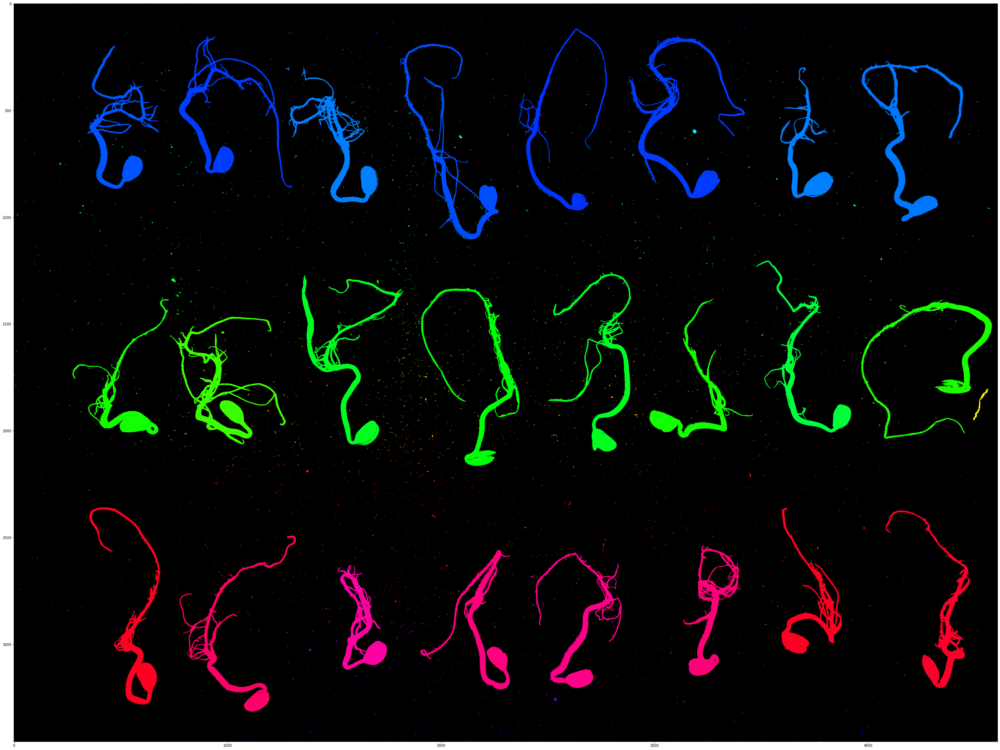

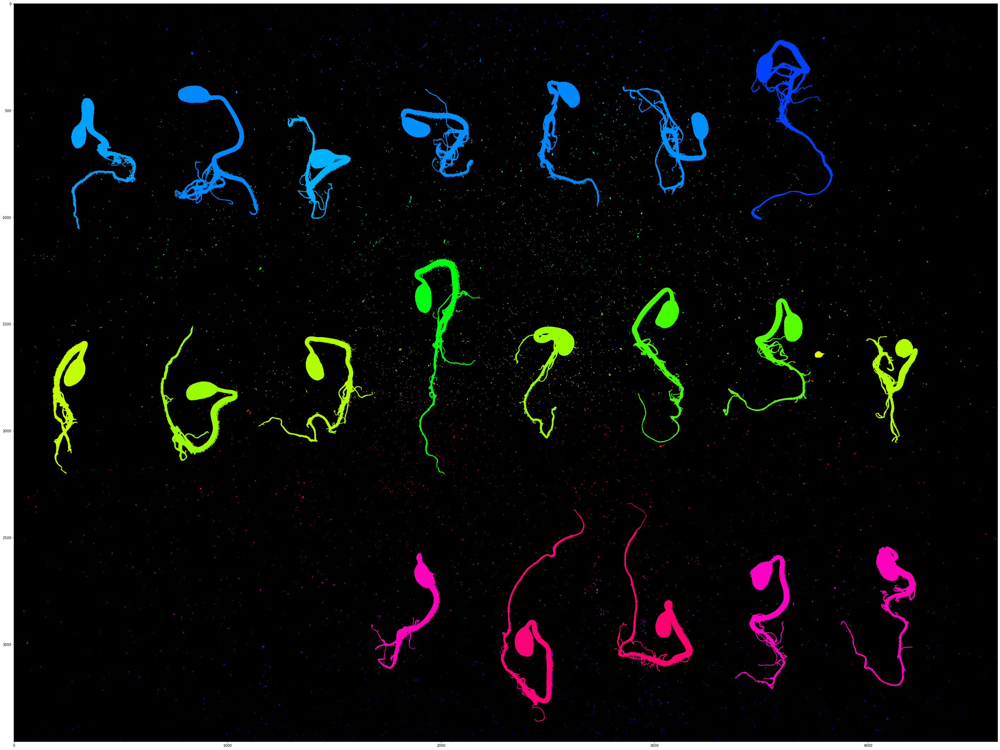

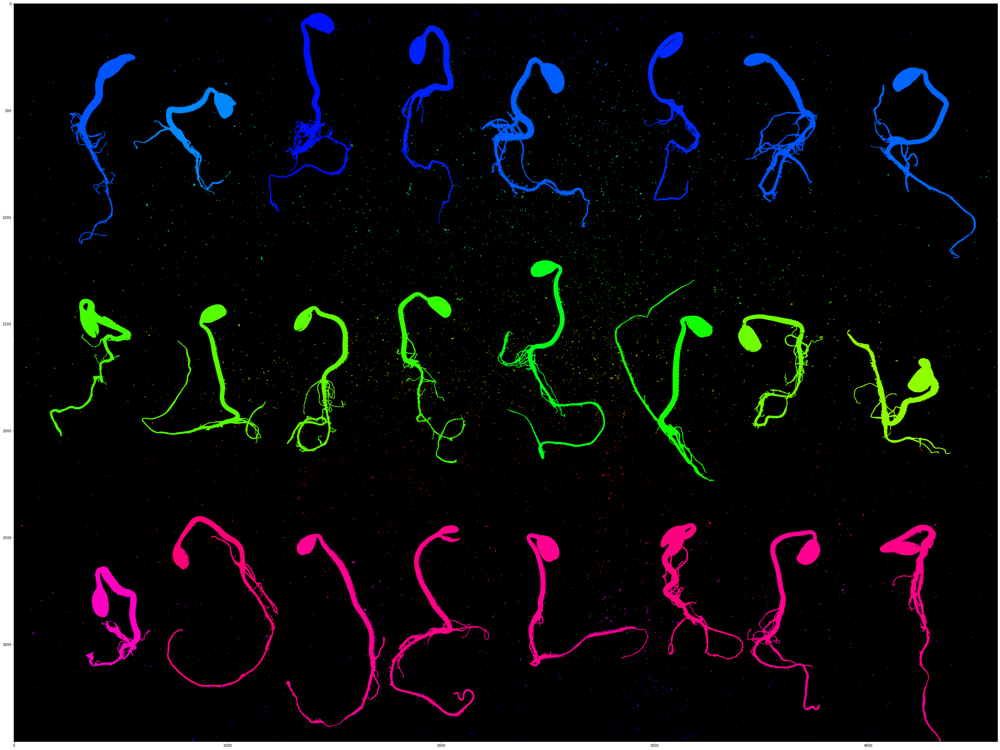

../Images/7_dias/Normais/images_cut/IMG_20201030_093833_1263.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093833.pngIMG_20201030_093833_1263.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142947_49.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142947.pngIMG_20201020_142947_49.png
../Images/7_dias/Normais/images_cut/IMG_20201030_100445_78.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_100445.pngIMG_20201030_100445_78.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091942_107.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091942.pngIMG_20201030_091942_107.png
../Images/7_dias/Normais/images_cut/IMG_20201009_151538_8381.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_151538.pngIMG_20201009_151538_8381.png
(3456, 4608, 3)
Number of components: 3005
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_153002_96.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153002.pngIMG_20201113_153002_96.png
../Images/7_dias/Normais/images_cut/IM

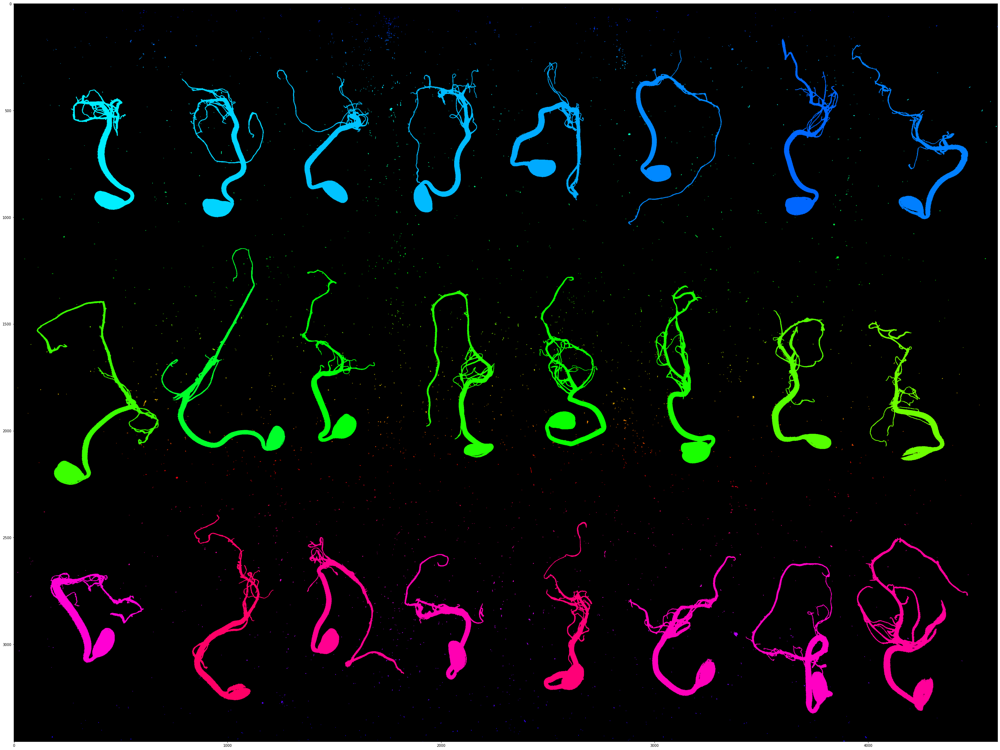

../Images/7_dias/Normais/images_cut/IMG_20201009_160001_4999.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160001.pngIMG_20201009_160001_4999.png
../Images/7_dias/Normais/images_cut/IMG_20201020_145556_138.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_145556.pngIMG_20201020_145556_138.png
../Images/7_dias/Normais/images_cut/IMG_20201020_153249_324.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_324.png
(3456, 4608, 3)
Number of components: 2676
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_1429.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_1429.png


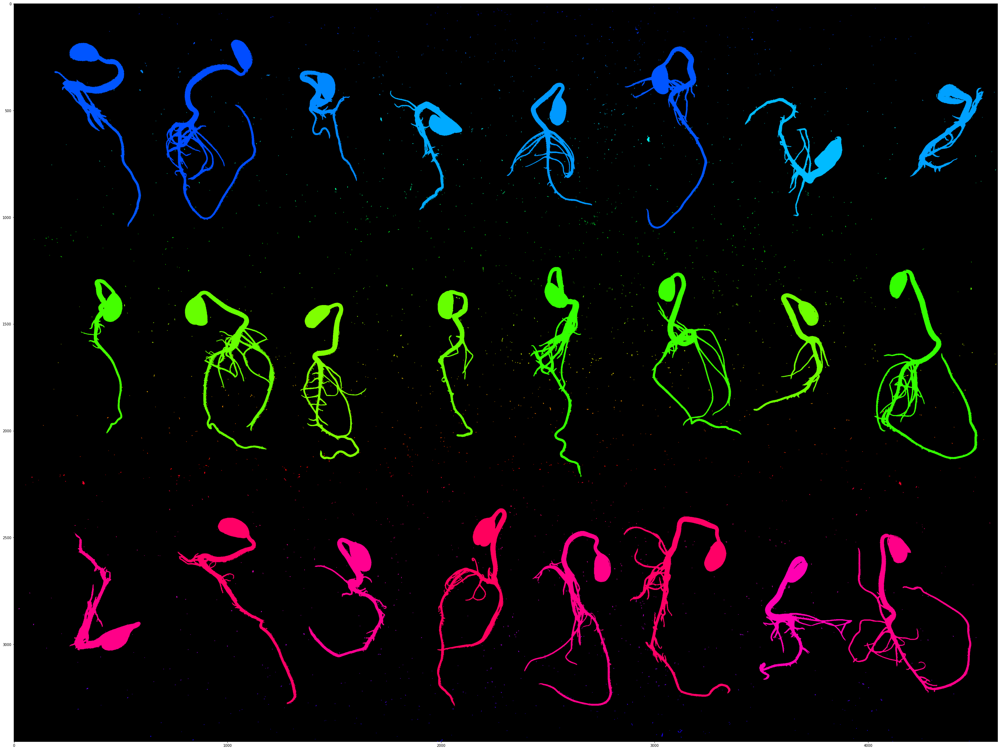

../Images/7_dias/Normais/images_cut/IMG_20201030_095140_422.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_422.png
../Images/7_dias/Normais/images_cut/IMG_20201020_150926_64.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_150926.pngIMG_20201020_150926_64.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152038_147.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152038.pngIMG_20201113_152038_147.png
../Images/7_dias/Normais/images_cut/IMG_20201020_154110_314.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_154110.pngIMG_20201020_154110_314.png
../Images/7_dias/Normais/images_cut/IMG_20201020_144017_90.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144017.pngIMG_20201020_144017_90.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_86.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_86.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091942_145.png ../Images/7_dias/Normais/masks_cut/IMG_202

Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_151111_1601.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_151111.pngIMG_20201113_151111_1601.png
../Images/7_dias/Normais/images_cut/IMG_20201020_141854_163.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_141854.pngIMG_20201020_141854_163.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095140_488.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_488.png
../Images/7_dias/Normais/images_cut/IMG_20201020_150926_311.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_150926.pngIMG_20201020_150926_311.png
../Images/7_dias/Normais/images_cut/IMG_20201020_144017_121.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144017.pngIMG_20201020_144017_121.png
../Images/7_dias/Normais/images_cut/IMG_20201020_154110_647.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_154110.pngIMG_20201020_154110_647.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152038_237.png ../Images/7_d

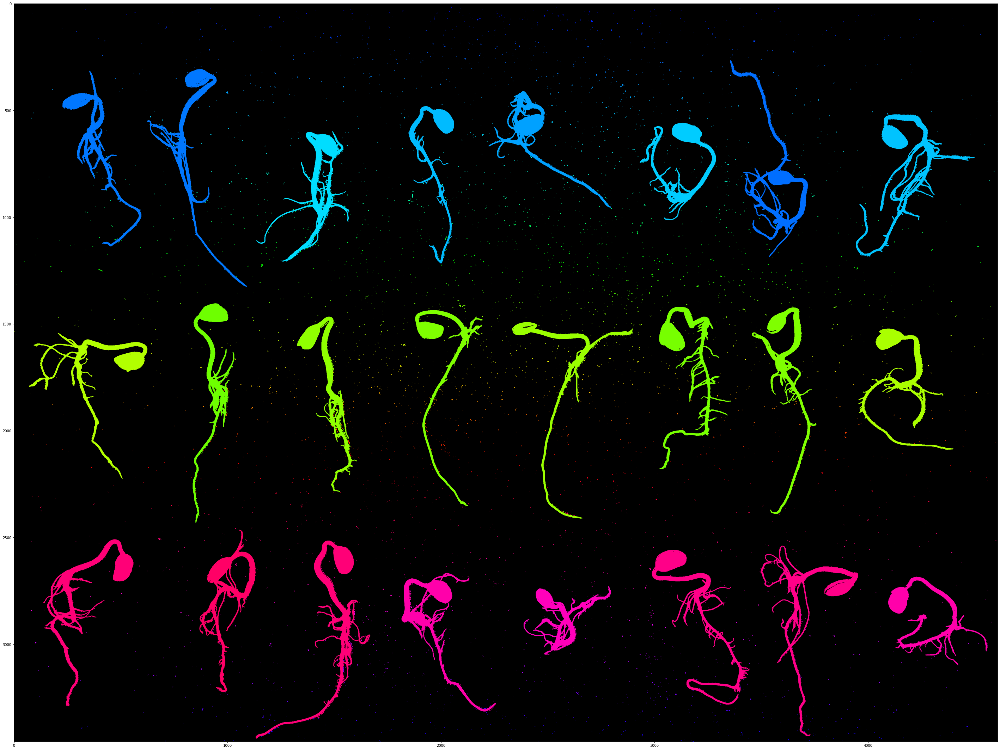

../Images/7_dias/Normais/images_cut/IMG_20201020_144017_545.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_144017.pngIMG_20201020_144017_545.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095140_1393.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_1393.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152038_347.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152038.pngIMG_20201113_152038_347.png
../Images/7_dias/Normais/images_cut/IMG_20201020_154110_726.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_154110.pngIMG_20201020_154110_726.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_438.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_438.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091942_755.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091942.pngIMG_20201030_091942_755.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201020_153249_607.png ../Images/7_d

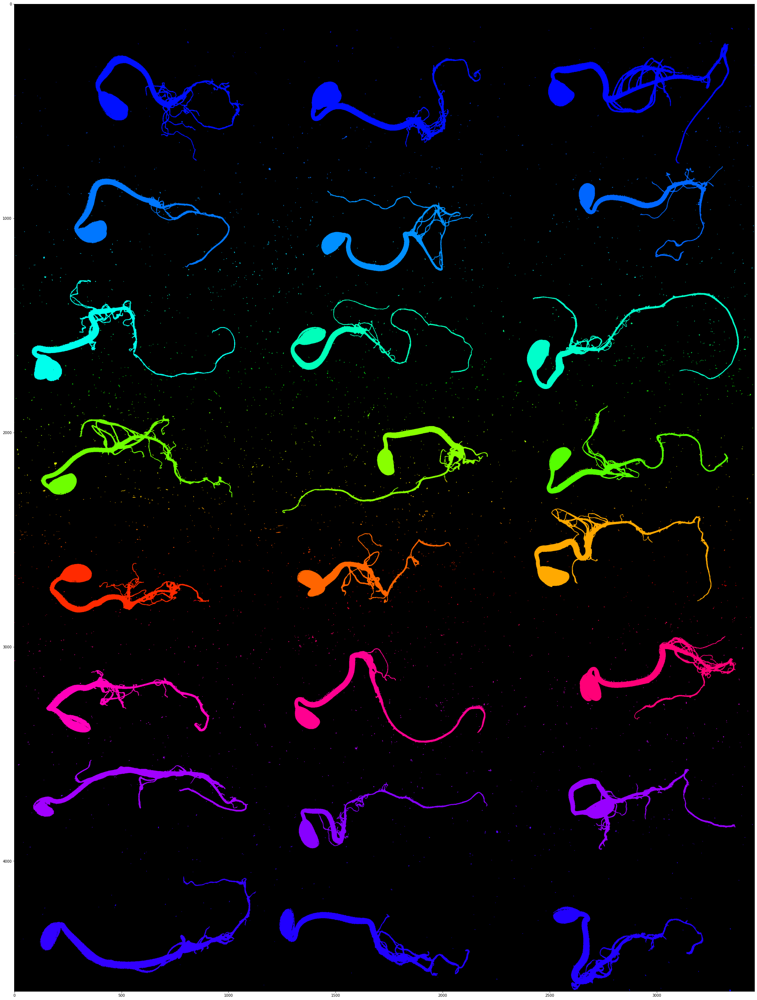

../Images/7_dias/Normais/images_cut/IMG_20201113_152038_374.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152038.pngIMG_20201113_152038_374.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095140_1474.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_1474.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_642.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_642.png
../Images/7_dias/Normais/images_cut/IMG_20201030_091942_848.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_091942.pngIMG_20201030_091942_848.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142947_642.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142947.pngIMG_20201020_142947_642.png
Corte pequeno demais
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201030_093833_2717.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_093833.pngIMG_20201030_093833_2717.png
../Images/7_dias/Normais/images_cut/IMG_20201113_15395

../Images/7_dias/Normais/images_cut/IMG_20201020_153249_1894.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_1894.png
../Images/7_dias/Normais/images_cut/IMG_20201020_154110_2687.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_154110.pngIMG_20201020_154110_2687.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_2650.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_2650.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153954_2039.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153954.pngIMG_20201113_153954_2039.png
../Images/7_dias/Normais/images_cut/IMG_20201020_141854_988.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_141854.pngIMG_20201020_141854_988.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_1902.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_1902.png
../Images/7_dias/Normais/images_cut/IMG_20201020_145556_781.png ../Images/7_dias/Normais/m

../Images/7_dias/Normais/images_cut/IMG_20201020_153249_2300.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_2300.png
../Images/7_dias/Normais/images_cut/IMG_20201020_141854_1028.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_141854.pngIMG_20201020_141854_1028.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153954_2122.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153954.pngIMG_20201113_153954_2122.png
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_2839.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_2839.png
../Images/7_dias/Normais/images_cut/IMG_20201030_103554_2787.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_2787.png
../Images/7_dias/Normais/images_cut/IMG_20201020_154110_3105.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_154110.pngIMG_20201020_154110_3105.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153002_2870.png ../Images/7_dias/Normai

../Images/7_dias/Normais/images_cut/IMG_20201030_103554_2831.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_103554.pngIMG_20201030_103554_2831.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201009_155337_1239.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_155337.pngIMG_20201009_155337_1239.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_152038_1519.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152038.pngIMG_20201113_152038_1519.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102909_2098.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_102909.pngIMG_20201030_102909_2098.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160608_797.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160608.pngIMG_20201009_160608_797.png
Corte pequeno demais
../Images/7_dias/Normais/images_cut/IMG_20201113_154751_5339.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_154751.pngIMG_20201113_154751_5339.png
../Images/7_dias/Normais/im

../Images/7_dias/Normais/images_cut/IMG_20201020_141854_1958.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_141854.pngIMG_20201020_141854_1958.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153002_4927.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153002.pngIMG_20201113_153002_4927.png
../Images/7_dias/Normais/images_cut/IMG_20201020_142947_1677.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_142947.pngIMG_20201020_142947_1677.png
../Images/7_dias/Normais/images_cut/IMG_20201009_155337_2315.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_155337.pngIMG_20201009_155337_2315.png
../Images/7_dias/Normais/images_cut/IMG_20201009_160608_1596.png ../Images/7_dias/Normais/masks_cut/IMG_20201009_160608.pngIMG_20201009_160608_1596.png
../Images/7_dias/Normais/images_cut/IMG_20201030_095140_2576.png ../Images/7_dias/Normais/masks_cut/IMG_20201030_095140.pngIMG_20201030_095140_2576.png
../Images/7_dias/Normais/images_cut/IMG_20201020_145556_1435.png ../Images/7_dias/Normai

../Images/7_dias/Normais/images_cut/IMG_20201020_153249_4445.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_153249.pngIMG_20201020_153249_4445.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153954_4354.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153954.pngIMG_20201113_153954_4354.png
../Images/7_dias/Normais/images_cut/IMG_20201020_150926_6946.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_150926.pngIMG_20201020_150926_6946.png
../Images/7_dias/Normais/images_cut/IMG_20201020_141854_2042.png ../Images/7_dias/Normais/masks_cut/IMG_20201020_141854.pngIMG_20201020_141854_2042.png
../Images/7_dias/Normais/images_cut/IMG_20201113_152038_3053.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_152038.pngIMG_20201113_152038_3053.png
../Images/7_dias/Normais/images_cut/IMG_20201113_153002_5117.png ../Images/7_dias/Normais/masks_cut/IMG_20201113_153002.pngIMG_20201113_153002_5117.png
../Images/7_dias/Normais/images_cut/IMG_20201030_102909_3768.png ../Images/7_dias/Normai

In [6]:
image_names = os.listdir(IMGS_PATH)

import multiprocessing 
  
# Yield successive n-sized 
# chunks from l. 
def divide_chunks(l, n): 
      
    # looping till length l 
    for i in range(0, len(l), n):  
        yield l[i:i + n] 

inputs = list(divide_chunks(image_names, 2)) 

processes = list()

for input in inputs:
    x = multiprocessing.Process(target=cut_images_func, args=(input, True,))
    processes.append(x)
    x.start()    



